In [5]:
from lofti_redesign import Fitter, FitOrbit

GL896A = 2824770686019003904
GL896B = 2824770686019004032

DSTucA = 6387058411482257536
DSTucB = 6387058411482257280
massA = (0.97, 0.04)
massB = (0.87, 0.04)

# Initialize the fitter object:
fitterobject = Fitter(DSTucA,DSTucB,massA,massB,Norbits = 10)
# run orbit fit:
orbits = FitOrbit(fitterobject)
# get fit results:
results = orbits.results

100% (10 of 10): |####################|  Done...
Time 17.421679973602295 0.29036133289337157 min 0.0048393555482228595 h


In [5]:
# How long did it take to do that run?
results.run_time

<Quantity 17.84476781 s>

## On limiting aop and lan:

In [2]:
# The lan parameter by default is limited to [0,180] deg in the absence of radial velocity information.  DS Tuc has RV in Gaia
# though, so we should not see it limited:
print(results.lan)
print(results.orbits[:,7])


[342.98862663 353.36491607 346.41383761 338.87601692 348.23601262
 346.42806114 321.7547652  347.06510756 114.20864882 349.14585514]
[342.98862663  -6.63508393 346.41383761 338.87601692 -11.76398738
 346.42806114 321.7547652  347.06510756 114.20864882 -10.85414486]


In [7]:
# But if there is no RV info, lan is by default limited to [0,180] deg interval.  The orbits attribute preserved
# the original value, but the lan attribute is the limited value:
from lofti_redesign import Results
GL896results = Results()
GL896results.LoadResults("FitResults.from.a.previous.run.GL896.pkl")
print(GL896results.lan)
print(GL896results.orbits[:,7])

[103.51916925  79.43607227  69.44309748 153.85043033  11.1353334
 114.86241257 152.97298379  79.06314597  37.5787509   78.32546499]
[ -76.48083075 -100.56392773   69.44309748 -206.14956967   11.1353334
 -245.13758743 -207.02701621 -100.93685403   37.5787509  -281.67453501]


In [8]:
# If we decide we don't want that, we can reset the lan attribute (mod 360):
GL896results.lan = GL896results.orbits[:,7] % 360
print(GL896results.lan)

[283.51916925 259.43607227  69.44309748 153.85043033  11.1353334
 114.86241257 152.97298379 259.06314597  37.5787509   78.32546499]


In [10]:
# If we decide to limit aop instead, we can replace .aop with orbits[:,6] % 180, or we can add it as a keyword
# when we create the Results object:
GL896results = Results(limit_aop = True)
GL896results.LoadResults("FitResults.from.a.previous.run.GL896.pkl")
print(GL896results.aop)
# but the orbits attribute still preserves the original values:
print(GL896results.orbits[:,6])

[ 41.69068997  63.00417452 147.84648818  83.79366542 107.76567041
  64.71041604  79.51135996   2.05808274 124.46578454 178.71563349]
[ 41.69068997  63.00417452 147.84648818 263.79366542 107.76567041
 244.71041604 259.51135996   2.05808274 124.46578454 178.71563349]


In [11]:
loaded_results.orbits[:,7] 

array([346.71504443,  -1.89631252, 343.73432596, -12.05101823,
       323.35183158, 346.98272302, 327.59027976,   7.03909256,
        80.55480864, 346.7168987 ])

### Handling results

In [ ]:
# load results from a previous run and append to this run:
print(len(results.sma))
# call the results object from the last run:
results.LoadResults("FitResults.from.a.previous.run.pkl", append = True)
# now the loaded results are appended to that run's results.
print(len(results.sma))

In [2]:
# loading previous results from pickle file:
from lofti_redesign import Results
# Make a new results object:
loaded_results = Results()
# populate that objects with the results from the previous run
loaded_results.LoadResults("FitResults.from.a.previous.run.pkl")
print(loaded_results.sma)

[4.24437603 3.89329871 3.9528082  4.89930919 3.4578694  8.3085165
 2.94485287 5.09772675 3.10962108 3.46766074]


In [1]:
# Retrieve the statistics from the loaded run:
from lofti_redesign import Results, Stats
# Make a new results object and load previous results:
loaded_results = Results()
loaded_results.LoadResults("FitResults.from.a.previous.run.pkl")
# make a stats object, cpute the stats, and write out automatically
loaded_results.stats = Stats(orbits = loaded_results.orbits, write_to_file = True, filename =\
    "FitResults.Stats.from.a.previous.run.txt")
print(loaded_results.stats.sma_mean)
print(loaded_results.stats.lan_ci68)

7.335698083846478
(80.55480863890307, 346.98272302271465)


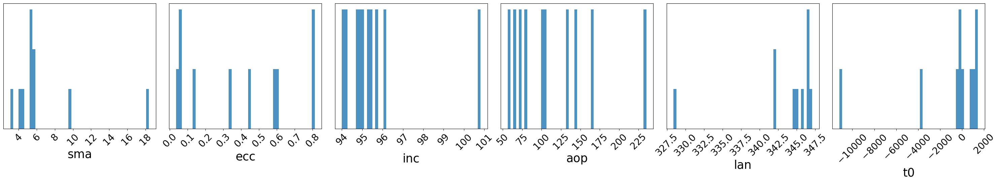

In [23]:
plt.style.use('default')
hists = results.PlotHists()

## Plotting

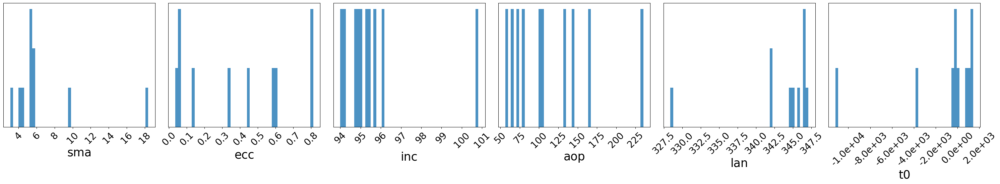

In [24]:
# You can make adjustments to the histograms by calling the individual histogram axes:
from matplotlib.ticker import FormatStrFormatter
hists.axes[-1].xaxis.set_major_formatter(FormatStrFormatter('%.1e'))
hists

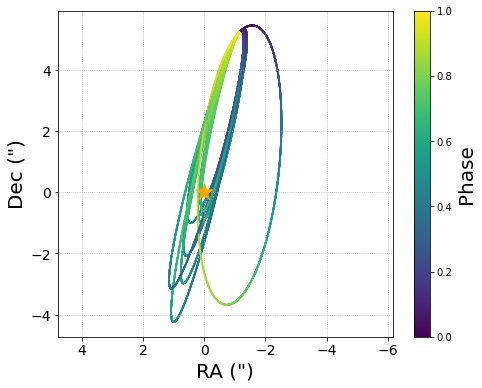

In [1]:
from lofti_redesign import Results
loaded_results = Results(limit_lan = False)
loaded_results.LoadResults("FitResults.from.a.previous.run.pkl")
plotorbits = loaded_results.PlotOrbits()

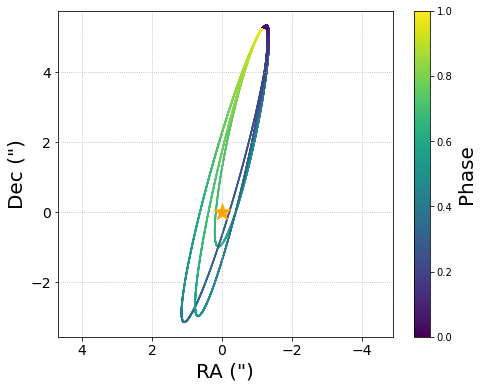

In [2]:
# If I want to plot fewer orbits:
plotorbits = loaded_results.PlotOrbits(size = 3)

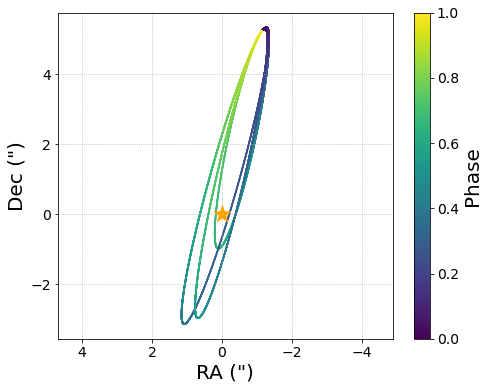

In [3]:
# the tick labels looks small
# on the colorbar:
plotorbits.axes[1].tick_params(labelsize=14)
# what if I don't want the grid lines?
plotorbits.axes[0].grid(b=False)
plotorbits

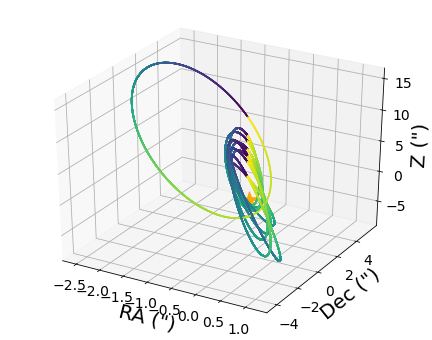

In [1]:
# You can make a 3d plot with the plot3d keyword:
from lofti_redesign import Results
loaded_results = Results(limit_lan = False)
loaded_results.LoadResults("FitResults.from.a.previous.run.pkl")
plotorbits3d = loaded_results.PlotOrbits(plot3d = True)

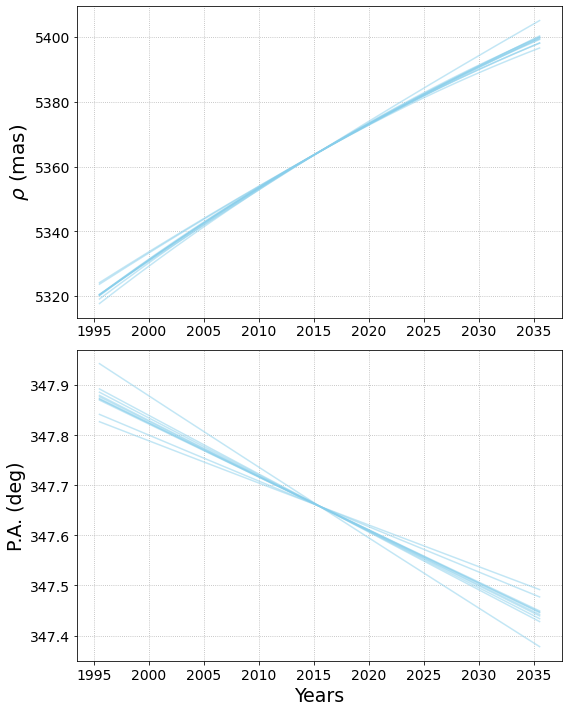

In [13]:
# You can make a 3d plot with the plot3d keyword:
from lofti_redesign import Results
loaded_results = Results(limit_lan = False)
loaded_results.LoadResults("FitResults.from.a.previous.run.pkl")
plotseppa = loaded_results.PlotSepPA()

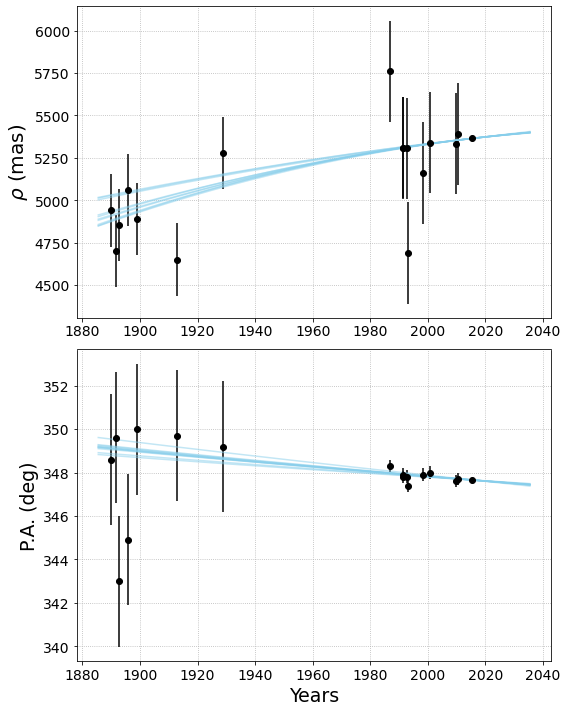

In [23]:
WDS = pd.read_csv('WDS_DSTuc.csv')
plotseppa = loaded_results.PlotSepPA(timespan=[130,20])
plotseppa.axes[0].errorbar(WDS['dates'],WDS['r'], yerr = WDS['rerr'], color='black', ls='none')
plotseppa.axes[0].scatter(WDS['dates'],WDS['r'], color = 'black', marker='o',zorder=10)
plotseppa.axes[1].errorbar(WDS['dates'],WDS['PA'], yerr = WDS['PAerr'], color='black', ls='none')
plotseppa.axes[1].scatter(WDS['dates'],WDS['PA'], color = 'black', marker='o',zorder=10)
